# ClimaX notebook

In [1]:
import os
from typing import Optional
from typing import Any
import numpy as np
import math
import random
import numpy as np
import click
import xarray as xr
from tqdm import tqdm
import glob
import warnings
from typing import List

import torch
import torchdata.datapipes as dp
from pytorch_lightning import LightningDataModule
from pytorch_lightning import LightningModule
from torch.utils.data import DataLoader, IterableDataset
from torchvision.transforms import transforms
from pytorch_lightning.cli import LightningCLI

from climax.arch import ClimaX
from climax.pretrain.datamodule import collate_fn
from climax.pretrain.datamodule import MultiSourceDataModule
from climax.pretrain.module import PretrainModule

from climax.pretrain.dataset import (
	Forecast,
	IndividualForecastDataIter,
	NpyReader,
	ShuffleIterableDataset,
)
from climax.utils.lr_scheduler import LinearWarmupCosineAnnealingLR
from climax.utils.metrics import (
	lat_weighted_acc,
	lat_weighted_mse,
	lat_weighted_mse_val,
	lat_weighted_rmse,
)
from climax.utils.pos_embed import interpolate_pos_embed
from climax.global_forecast.datamodule import GlobalForecastDataModule
from climax.global_forecast.module import GlobalForecastModule

from torch.optim import Optimizer
from torch.optim.lr_scheduler import _LRScheduler

from functools import lru_cache

import torch.nn as nn
from timm.models.vision_transformer import Block, PatchEmbed, trunc_normal_

from climax.utils.pos_embed import (
	get_1d_sincos_pos_embed_from_grid,
	get_2d_sincos_pos_embed,
)
from climax.utils.data_utils import DEFAULT_PRESSURE_LEVELS, NAME_TO_VAR
import holoviews as hv
import matplotlib
from matplotlib import pyplot as plt
from IPython.display import Image
from IPython.core.display import HTML 

In [16]:
def RMSELoss(yhat,y):
    return torch.sqrt(torch.mean((yhat-y)**2))

# Climax model
Paper link: https://arxiv.org/pdf/2301.10343.pdf

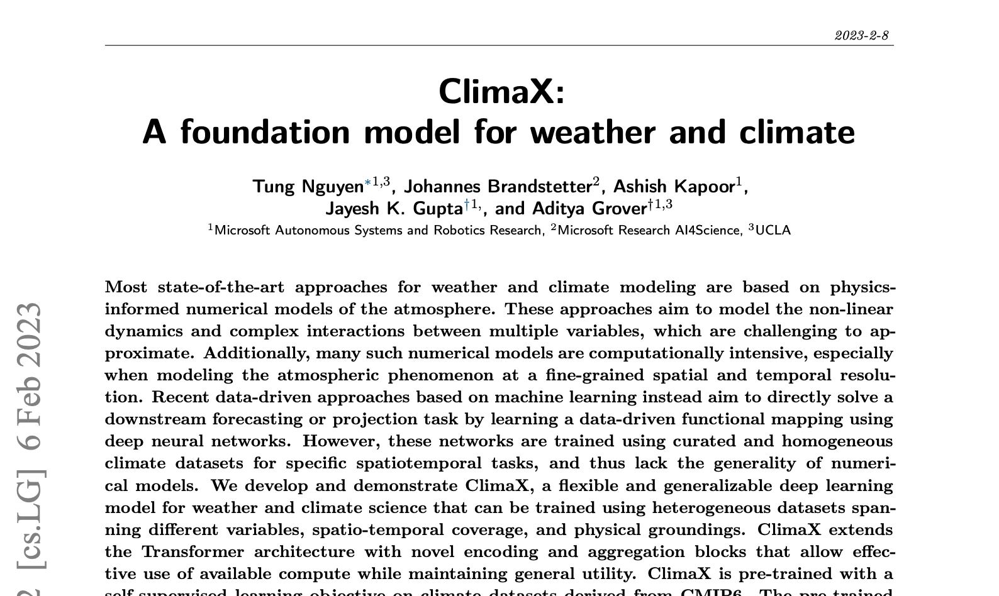

In [14]:
Image(filename = "/scratch/fp0/shared/ClimaX/Clim-1.png", width=700, height=750)

# WeatherBench data
Paper link: https://arxiv.org/pdf/2002.00469.pdf

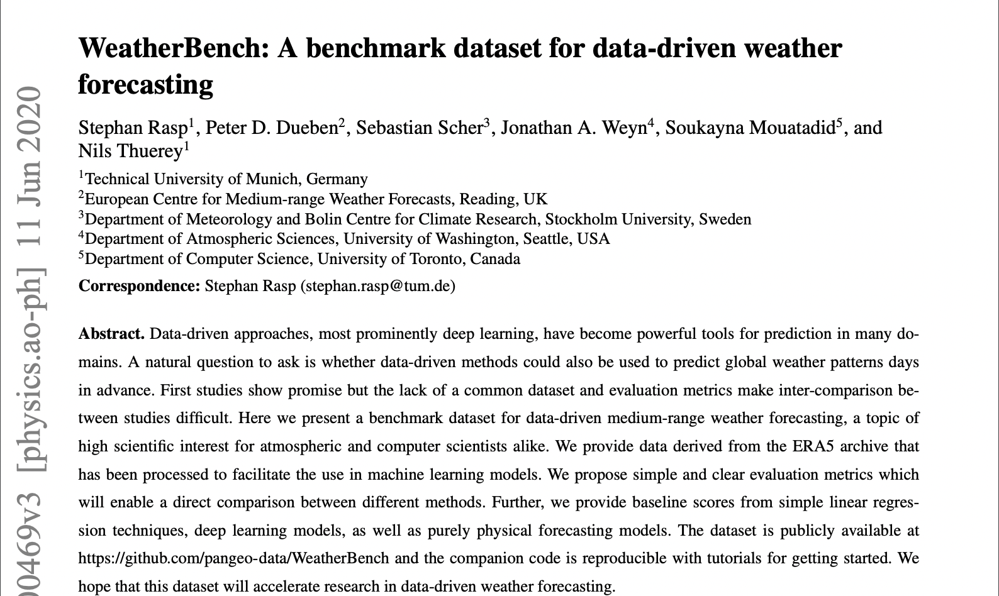

In [15]:
Image(filename = "/scratch/fp0/shared/ClimaX/weather-1.png", width=700, height=750)

# Code and Data loction.
Singularity container, script, and configuration files are located in: `/scratch/fp0/shared/ClimaX/`. <br>
WeatherBench data is location: `/g/data/wb00/admin/staging/weatherbench/`

In [19]:
! ls -lh /g/data/wb00/admin/staging/weatherbench/5.625deg/ 

total 593K
drwxrws---+ 2 mah900 wb00 41K Feb  9 23:52 10m_u_component_of_wind
drwxrws---+ 2 mah900 wb00 41K Feb  9 23:53 10m_v_component_of_wind
drwxrws---+ 2 mah900 wb00 41K Feb  9 23:53 2m_temperature
-rw-rw----+ 1 mah900 wb00 68K Feb  9 23:53 constants.nc
drwxrws---+ 2 mah900 wb00 41K Feb  9 23:59 geopotential
drwxrws---+ 2 mah900 wb00 41K Feb 10 00:04 relative_humidity
drwxrws---+ 2 mah900 wb00 41K Feb 10 00:09 specific_humidity
drwxrws---+ 2 mah900 wb00 41K Feb 10 00:15 temperature
drwxrws---+ 2 mah900 wb00 41K Feb 10 00:16 toa_incident_solar_radiation
drwxrws---+ 2 mah900 wb00 41K Feb 10 00:16 total_precipitation
drwxrws---+ 2 mah900 wb00 41K Feb 10 00:21 u_component_of_wind
drwxrws---+ 2 mah900 wb00 41K Feb 10 00:26 v_component_of_wind


In [20]:
! ls -lh /g/data/wb00/admin/staging/weatherbench/5.625deg_npz/ 

total 284K
-rw-rw----+ 1 mah900 wb00 384 Feb 16 22:04 lat.npy
-rw-rw----+ 1 mah900 wb00 640 Feb 16 22:04 lon.npy
-rw-rw----+ 1 mah900 wb00 16K Feb 16 22:02 normalize_mean.npz
-rw-rw----+ 1 mah900 wb00 16K Feb 16 22:02 normalize_std.npz
drwxrws---+ 2 mah900 wb00 33K Mar  7 21:39 pred
drwxrws---+ 2 mah900 wb00 33K Feb 16 22:04 test
drwxrws---+ 2 mah900 wb00 57K Feb 16 22:02 train
drwxrws---+ 2 mah900 wb00 33K Feb 16 22:03 val


# PBS Script - Model finetune

This script can be used to fine tune the model on eight GPUs.

Script loacation: `/scratch/fp0/shared/ClimaX/global_train_8_sin.pbs`

---
**PBS Script**
```bash
#!/bin/bash
#PBS -S /bin/bash
#PBS -q gpuvolta
#PBS -l ncpus=96
#PBS -l ngpus=8
#PBS -l jobfs=800GB
#PBS -l storage=scratch/fp0+gdata/z00+gdata/fp0+gdata/dk92+gdata/in10+gdata/fs38+scratch/z00+gdata/wb00
#PBS -l mem=760GB
#PBS -l walltime=08:00:00
#PBS -N Gl_G_8_s_20
#PBS -P fp0
export WORLD_SIZE=$PBS_NGPUS  #1
export MASTER_ADDR=$(head -n 1 $PBS_NODEFILE | uniq )  #2
export MASTER_PORT=10002   #3
export TOT_NODES=$PBS_NNODES    #4
export GPU_PER_NODE=4  #5
export MAX_EPOCHS=20  #6
export OUTPUT_DIR="/scratch/fp0/shared/climax_train_global"
export CONFIG_PATH='/scratch/fp0/shared/ClimaX/configs/global_forecast_climax.yaml'  
export ROOT_DIR='/g/data/wb00/admin/staging/weatherbench/5.625deg_npz' 
export PRETRAIN_PATH='/g/data/wb00/admin/staging/weatherbench/ClimaX-5.625deg.ckpt'  
export PROG_BAR='True'

N_LIST=''
while IFS= read -r line ; do
         N_LIST+="${line::-16}:1," 
done < <(cat $PBS_NODEFILE | uniq)       
N_LIST=${N_LIST::-1}
echo ${N_LIST}
module load singularity
module load openmpi/4.1.1
mpirun -np ${PBS_NNODES} \
    -H ${N_LIST} \
    -bind-to none --map-by slot \
    -x NCCL_DEBUG=INFO -x LD_LIBRARY_PATH -x PATH \
    -mca pml ob1 -mca btl ^openib \
    /scratch/fp0/shared/ClimaX/global_mn_sin.sh
```    
---

# Prediction

The Climax code does not have a prediction module. I have added a prediction code to the singularity image. This code is different from the code available in the original repository and includes a prediction script, configuration file, and data loading module. 

In [11]:
import os
os.chdir('/scratch/fp0/shared/ClimaX')
os.environ['OUTPUT_DIR']='/scratch/fp0/shared/climax_train_global'
!python \
    src/climax/global_forecast/predict.py \
    --config 'configs/prediction.yaml' \
    --trainer.num_nodes=1 \
    --trainer.strategy=ddp --trainer.devices=1 \
    --data.root_dir='/g/data/wb00/admin/staging/weatherbench/5.625deg_npz' \
    --data.predict_range=72 \
    --data.out_variables=['geopotential_500','temperature_850','2m_temperature'] \
    --data.batch_size=16 \
    --data.num_workers=1 \
    --model.pretrained_path='/g/data/wb00/admin/staging/weatherbench/ClimaX-5.625deg.ckpt' \
    --model.lr=5e-7 --model.beta_1="0.9" --model.beta_2="0.99" \
    --model.weight_decay=1e-5


Global seed set to 42
Loading pre-trained checkpoint from: /g/data/wb00/admin/staging/weatherbench/ClimaX-5.625deg.ckpt
<All keys matched successfully>
Using 16bit native Automatic Mixed Precision (AMP)
Trainer already configured with model summary callbacks: [<class 'pytorch_lightning.callbacks.rich_model_summary.RichModelSummary'>]. Skipping setting a default `ModelSummary` callback.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
[rank: 0] Global seed set to 42
Initializing distributed: GLOBAL_RANK: 0, MEMBER: 1/1
----------------------------------------------------------------------------------------------------
distributed_backend=nccl
All distributed processes registered. Starting with 1 processes
----------------------------------------------------------------------------------------------------

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Predicting ━━━━━━━━━━━━━━━━━━━━━━━━━━━━

In [14]:
import os
import torch
os.chdir('/scratch/fp0/shared/climax_train_global/pred')
with open('pred.pt','rb') as f:
    pred = torch.load(f) 

geopotential_500_y = pred[0][1][:,0]
temperature_850_y  = pred[0][1][:,1]
temperature_y      = pred[0][1][:,2]

geopotential_500_pred = pred[0][2][:,0]
temperature_850_pred  = pred[0][2][:,1]
temperature_pred      = pred[0][2][:,2]
#print (geopotential_500_y.shape)
for i in range (1,16):
    geopotential_500_y = torch.cat((geopotential_500_y, pred[i][1][:,0]), 0)
    temperature_850_y  = torch.cat((temperature_850_y,  pred[i][1][:,1]), 0)
    temperature_y      = torch.cat((temperature_y,      pred[i][1][:,2]), 0)
    
    geopotential_500_pred = torch.cat((geopotential_500_pred, pred[i][2][:,0]), 0)
    temperature_850_pred  = torch.cat((temperature_850_pred,  pred[i][2][:,1]), 0)
    temperature_pred      = torch.cat((temperature_pred,      pred[i][2][:,2]), 0)
print (geopotential_500_y.shape, temperature_850_y.shape, temperature_y.shape)
print (geopotential_500_pred.shape, temperature_850_pred.shape, temperature_pred.shape)

torch.Size([256, 32, 64]) torch.Size([256, 32, 64]) torch.Size([256, 32, 64])
torch.Size([256, 32, 64]) torch.Size([256, 32, 64]) torch.Size([256, 32, 64])


In [19]:
%%time 
%matplotlib inline 
import matplotlib.colors as colors
import matplotlib.image as mpimg
from matplotlib import rcParams
import matplotlib.animation as animation
from IPython.display import HTML
import matplotlib.pyplot as plt
import numpy as np

plt.rcParams['animation.embed_limit'] = 2**128    
plt.rcParams["figure.figsize"] = [15,12]
#plt.rcParams["figure.autolayout"] = True 
plt.subplots_adjust(bottom=0, right=1, top=1, left=0)
print (geopotential_500_y.shape)

fig = plt.figure()
#fig.set_figheight(10)
#fig.set_figwidth(10)
ax1 = fig.add_subplot(321)
ax4 = fig.add_subplot(322)
ax2 = fig.add_subplot(323)
ax5 = fig.add_subplot(324)
ax3 = fig.add_subplot(325)
ax6 = fig.add_subplot(326)

ax1.title.set_text('geopotential_500')
ax2.title.set_text('temperature_850')
ax3.title.set_text('2m_temperature')
ax4.title.set_text("Prediction, RMSE: " + str(round ( RMSELoss(geopotential_500_pred[0],geopotential_500_y [0]).item(),3) ) )
ax5.title.set_text("Prediction, RMSE: " + str(round ( RMSELoss(temperature_850_pred[0], temperature_850_y[0]).item(),3) ) )
ax6.title.set_text("Prediction, RMSE: " + str(round ( RMSELoss(temperature_pred[0],     temperature_y [0]).item(),3) ) )

color_map ='Spectral_r'
inter = 'nearest'
#mi = np.min (geopotential_500_y  )
#mx = np.max (geopotential_500_y  )
imart1 = ax1.imshow(geopotential_500_y [0])
imart2 = ax2.imshow(temperature_850_y  [0])
imart3 = ax3.imshow(temperature_y      [0])
imart4 = ax4.imshow(geopotential_500_pred [0])
imart5 = ax5.imshow(temperature_850_pred  [0])
imart6 = ax6.imshow(temperature_pred      [0])
imart  = [imart1, imart2, imart3, imart4, imart5, imart6 ] 

def init():
    return imart 

def update(val):
    imart[0].set_data(geopotential_500_y [val])
    imart[1].set_data(temperature_850_y [val])
    imart[2].set_data(temperature_y [val])
    imart[3].set_data(geopotential_500_pred [val])
    imart[4].set_data(temperature_850_pred [val])
    imart[5].set_data(temperature_pred [val])
    ax4.title.set_text("Prediction, RMSE: " + str(round ( RMSELoss(geopotential_500_pred[val],geopotential_500_y [val]).item(),3) ) )
    ax5.title.set_text("Prediction, RMSE: " + str(round ( RMSELoss(temperature_850_pred[val], temperature_850_y[val]).item(),3) ) )
    ax6.title.set_text("Prediction, RMSE: " + str(round ( RMSELoss(temperature_pred[val],     temperature_y [val]).item(),3) ) )

    return imart
ani = animation.FuncAnimation(fig, update, frames=len(geopotential_500_y), 
                              init_func=init,
                              interval=3, blit=True)
plt.close()


torch.Size([256, 32, 64])
CPU times: user 283 ms, sys: 3.41 ms, total: 286 ms
Wall time: 282 ms


<Figure size 1500x1200 with 0 Axes>

In [20]:
%%time 
from matplotlib import rc
rc('animation', html='jshtml')
ani

CPU times: user 50 µs, sys: 12 µs, total: 62 µs
Wall time: 67 µs
